# Overview
## 01- Data CLeaning
- 01- Correcting the Date Formats
- 02- Checking Null Values
- 03- Dropping unecessary columns
- 04- Handling Missing Values
## 02- NLP 
- 01- Preprocessing (Tokenization + Lemmatization)
- 02- Word Frequency Analysis
- 03- WordCloud
- 04- Patents Similarity
- 05- Inventor Network
- 06- Geospatial Analysis

## 01-Data Cleaning 

In [82]:
from pyspark.sql import SparkSession
from pyspark.sql.functions import col
from pyspark.sql.functions import isnan
from pyspark.sql.functions import desc
from pyspark.sql.functions import to_date, datediff
from pyspark.sql.functions import lit
from pyspark.sql.functions import expr
from pyspark.sql.functions import when, isnan, isnull
from pyspark.sql.functions import size, split

In [83]:
from pyspark.sql import SparkSession
spark = SparkSession.builder \
    .appName("YourApp") \
    .config("spark.jars.packages", "org.mongodb.spark:mongo-spark-connector_2.12:3.0.0") \
    .getOrCreate()

In [84]:
# MongoDB Details
mongo_ip = "mongodb://127.0.0.1:27017/"
db_name = "BIGDATA"  # Replace with your MongoDB database name
collection_name = "Canadian-Patent"  # Replace with your MongoDB collection name

df = spark.read.format("com.mongodb.spark.sql.DefaultSource") \
    .option("uri", mongo_ip + db_name + "." + collection_name) \
    .load()

# Show the DataFrame schema and the first few rows
df.printSchema()
df.show()

root
 |-- Abstract: string (nullable = true)
 |-- Agent: string (nullable = true)
 |-- App Number: string (nullable = true)
 |-- Application Number: double (nullable = true)
 |-- Canadian Patent Classification: string (nullable = true)
 |-- Claims: string (nullable = true)
 |-- Country: string (nullable = true)
 |-- Date: string (nullable = true)
 |-- English Title: string (nullable = true)
 |-- Filled Date: string (nullable = true)
 |-- French Title: string (nullable = true)
 |-- Inventors: string (nullable = true)
 |-- Issued: string (nullable = true)
 |-- Language of Filling: string (nullable = true)
 |-- Owners: string (nullable = true)
 |-- Patent: string (nullable = true)
 |-- Title: string (nullable = true)
 |-- _id: struct (nullable = true)
 |    |-- oid: string (nullable = true)

+--------------------+--------------------+--------------+------------------+------------------------------+--------------------+--------------------+----------+--------------------+-----------+------

24/05/06 22:16:23 WARN MongoInferSchema: Field 'Agent' contains conflicting types converting to StringType
24/05/06 22:16:23 WARN MongoInferSchema: Field 'App Number' contains conflicting types converting to StringType
24/05/06 22:16:23 WARN MongoInferSchema: Field 'Canadian Patent Classification' contains conflicting types converting to StringType
24/05/06 22:16:23 WARN MongoInferSchema: Field 'Country' contains conflicting types converting to StringType
24/05/06 22:16:23 WARN MongoInferSchema: Field 'Date' contains conflicting types converting to StringType
24/05/06 22:16:23 WARN MongoInferSchema: Field 'Issued' contains conflicting types converting to StringType


In [85]:
df.take(5)

[Row(Abstract='Linvention concerne un véhicule électrique, une station de recharge de batterie et un système de réservation déchange de batterie de véhicule électrique comportant celle-ci. Le véhicule électrique comprend une unité de détection du niveau de puissance adaptée pour détecter un niveau de puissance dune batterie installée dans le véhicule électrique; une unité de communication adaptée pour communiquer avec une station de recharge de batterie; et une unité de commande adaptée pour déterminer une station de recharge de batterie dans laquelle la batterie du véhicule électrique doit être échangée, en fonction du niveau de puissance de la batterie et du trajet du véhicule électrique, puis pour transmettre une commande de réservation déchange de batterie à la station de recharge de batterie déterminée. Selon le niveau de puissance de batterie du véhicule électrique, une station de recharge de batterie se trouvant sur le trajet doit transmettre linformation relative à la batterie.

In [86]:
# Replace spaces with underscores in column names
new_column_names = [col.replace(' ', '_') for col in df.columns]

# Apply the new column names to the DataFrame
for old_name, new_name in zip(df.columns, new_column_names):
    df = df.withColumnRenamed(old_name, new_name)

# Show the DataFrame schema with modified column names
df.printSchema()

root
 |-- Abstract: string (nullable = true)
 |-- Agent: string (nullable = true)
 |-- App_Number: string (nullable = true)
 |-- Application_Number: double (nullable = true)
 |-- Canadian_Patent_Classification: string (nullable = true)
 |-- Claims: string (nullable = true)
 |-- Country: string (nullable = true)
 |-- Date: string (nullable = true)
 |-- English_Title: string (nullable = true)
 |-- Filled_Date: string (nullable = true)
 |-- French_Title: string (nullable = true)
 |-- Inventors: string (nullable = true)
 |-- Issued: string (nullable = true)
 |-- Language_of_Filling: string (nullable = true)
 |-- Owners: string (nullable = true)
 |-- Patent: string (nullable = true)
 |-- Title: string (nullable = true)
 |-- _id: struct (nullable = true)
 |    |-- oid: string (nullable = true)



### 01- Correcting the Date Formats

In [87]:
df = df.withColumn('Date', to_date(col('Date'), 'yyyy-MM-dd'))

In [88]:
df = df.withColumn('Issued', to_date(col('Issued'), 'yyyy-MM-dd'))

In [89]:
df = df.withColumn('Filled_Date', to_date(col('Filled_Date'), 'yyyy-MM-dd'))

In [90]:
df.printSchema()

root
 |-- Abstract: string (nullable = true)
 |-- Agent: string (nullable = true)
 |-- App_Number: string (nullable = true)
 |-- Application_Number: double (nullable = true)
 |-- Canadian_Patent_Classification: string (nullable = true)
 |-- Claims: string (nullable = true)
 |-- Country: string (nullable = true)
 |-- Date: date (nullable = true)
 |-- English_Title: string (nullable = true)
 |-- Filled_Date: date (nullable = true)
 |-- French_Title: string (nullable = true)
 |-- Inventors: string (nullable = true)
 |-- Issued: date (nullable = true)
 |-- Language_of_Filling: string (nullable = true)
 |-- Owners: string (nullable = true)
 |-- Patent: string (nullable = true)
 |-- Title: string (nullable = true)
 |-- _id: struct (nullable = true)
 |    |-- oid: string (nullable = true)



### 02- Checking Null Values in all columns

In [91]:
df.filter((col('Abstract').isNull()) | (col('Abstract') == '') | (isnan(col('Abstract')))).count()

0

In [92]:
df.filter((col('Title').isNull())| (col('Title') == '') | (isnan(col('Title')))).count()

0

In [93]:
df.filter((col('Application_Number').isNull())| (col('Application_Number') == '') | (isnan(col('Application_Number')))).count()

465

In [94]:
df.filter((col('Claims').isNull())| (col('Claims') == '') | (isnan(col('Claims')))).count()

0

In [95]:
df.filter((col('Country').isNull())| (col('Country') == '') | (isnan(col('Country')))).count()

38

In [96]:
df.filter((col('Date').isNull()) | (col('Date') == '')).count()

38

In [97]:
df.filter((col('English_Title').isNull()) | (col('English_Title') == '') | (isnan(col('English_Title')))).count()

0

In [98]:
df.filter((col('Filled_Date').isNull()) | (col('Filled_Date') == '')).count()

0

In [99]:
df.filter((col('French_Title').isNull()) | (col('French_Title') == '') | (isnan(col('French_Title')))).count()

0

In [100]:
df.filter((col('Inventors').isNull())| (col('Inventors') == '') | (isnan(col('Inventors')))).count()

0

In [101]:
df.filter((col('Issued').isNull())).count()

217

In [102]:
df.filter((col('Language_of_Filling').isNull()) | (col('Language_of_Filling') == '')).count()

0

In [103]:
df.filter((col('Owners').isNull())| (col('Owners') == '') | (isnan(col('Owners')))).count()

0

In [104]:
df.filter((col('Patent').isNull())| (col('Patent') == '') | (isnan(col('Patent')))).count()

0

In [105]:
df.filter((col('Canadian_Patent_Classification').isNull())| (col('Canadian_Patent_Classification') == '') | (isnan(col('Canadian_Patent_Classification')))).count()

463

In [106]:
df.filter((isnan(col('App_Number')))).count()

38

### 03- Dropping unecessary columns

First we start by deleting the ID column.

In [107]:
df = df.drop('_id')

And we can clearly see that the columns 'Canadian Patent Classification' and 'Application Number' are mostly null so we're going to proceed by deleting both of them.

In [108]:
df = df.drop('Canadian_Patent_Classification')

In [109]:
df = df.drop('Application_Number')

In [110]:
df = df.drop('Title')

### 04- Handling Missing Values

For the 'Date' column we're going to fill the null values with Unknown.

In [111]:
date_counts = df.filter(col('Date').isNotNull()).groupBy('Date').count()

max_occurrence_date = date_counts.orderBy(col('count').desc()).select('Date').first()[0]

df = df.withColumn('Date', when(col('Date').isNull(), max_occurrence_date).otherwise(col('Date')))

For the 'Country' column, we're going To fill the null values with 'Unknown'.

In [112]:
df = df.withColumn('Country', when(isnan(col('Country')), 'Unknown').otherwise(col('Country')))

For the 'Issued' column, since the number of the null values is huge and approximately half the dataset, we can't risk delete it so we're going to fill them with 'Unknown'.

In [113]:
df = df.withColumn('Issued', when(col('Issued').isNull(), 'Unknown').otherwise(col('Issued')))

In [114]:
df = df.withColumn('App_Number', when(col('App_Number') == 'NaN', 'Unknown').otherwise(col('App_Number')))

In [115]:
df.select('Claims').show(465)

+--------------------+
|              Claims|
+--------------------+
|26\nClaims\nWhat ...|
|What is claimed i...|
|CA 03111811 2021-...|
|WHAT IS CLAIMED I...|
|WHAT IS CLAIMED I...|
|WHAT IS CLAIMED I...|
|Claims\nWhat is c...|
|-30-\nTHE EMBODIM...|
|26\nClaims\nWhat ...|
|What is claimed i...|
|CA 03111811 2021-...|
|WHAT IS CLAIMED I...|
|WHAT IS CLAIMED I...|
|WHAT IS CLAIMED I...|
|Claims\nWhat is c...|
|-30-\nTHE EMBODIM...|
|WO 2023/279135\nP...|
|WHAT IS CLAIMED I...|
|WO 2022/082314\nP...|
|27\nWHAT IS CLAIM...|
|CLAIMS\nWhat is c...|
|CLAIMS\n1.    A\n...|
|WO 2022/106971\nP...|
|34\nCLAIMS\nWhat ...|
|CLAIMS:\n1.    An...|
|WHAT IS CLAIMED I...|
|27\nCLAIMS\n1.   ...|
|WHAT IS CLAIMED I...|
|CA 03087315 2020-...|
|WHAT IS CLAIMED I...|
|WO 2022/256062\nP...|
|11\nREVENDICATION...|
|CLAIMS:\n1. A\nba...|
|20\nWHAT IS CLAIM...|
|CA 03099273 2020-...|
|9\nCLAIMS\n1. A\n...|
|WO 2021/257270\nP...|
|What is claimed i...|
|What is claimed i...|
|- 11 -\nWHAT IS C...|
|26\nCLAIMS

In [116]:
df = df.withColumn('Num_Lines_Claims', size(split(col('Claims'), '\n')))

In [119]:
df.rename(columns={'Filled_Date': 'Filing_Date'}, inplace=True)

In [ ]:
df.printSchema()

In [118]:
df = df.toPandas()

In [120]:
df

,Abstract,Agent,App_Number,Claims,Country,Date,English_Title,Filing_Date,French_Title,Inventors,Issued,Language_of_Filling,Owners,Patent,Num_Lines_Claims
0,"Linvention concerne un véhicule électrique, un...",BRION RAFFOUL,Unknown,26\nClaims\nWhat is claimed is:\n1. An\nelectr...,Unknown,2021-06-11,"ELECTRICVEHICLE,BATTERYCHARGING STATION,BATTER...",2012-06-22,"VEHICULE ELECTRIQUE, STATION DE RECHARGE DE BA...","PARK, JUN-SEOK, KIM, WON-KYU, PARK, HEE-JEING,...",2015-12-01,English,KOOKMIN UNIVERSITY INDUSTRY ACADEMY COOPERATIO...,CA 2781348,478
1,La présente invention concerne un véhicule éle...,FASKEN MARTINEAU DUMOULIN LLP,"60/973,794",What is claimed is:\n1. A method for providing...,United States of America,2007-09-20,ELECTRICVEHICLENETWORK,2008-09-19,RESEAU DE VEHICULE ELECTRIQUE,"AGASSI, SHAI, ZARUR, ANDREY J.",Unknown,English,BETTER PLACE GMBH,CA 2737243,685
2,L'invention concerne un dispositif conçu pour ...,PRAXIS,"62/727,346",CA 03111811 2021-03-05\nWO 2020/047647\nPCT/CA...,United States of America,2018-09-05,INTEGRATEDBATTERYBOOSTER DEVICE FORVEHICLEAND ...,2019-09-05,BLOC D'ALIMENTATION POUR DEMARRAGE DE SECOURS ...,"VALDEVIT, RICHARD, MANCINI, ANTONIO, TABAH, GA...",Unknown,English,EZBOOSTR INC.,CA 3111811,424
3,Un dispositif de charge et un appareil de char...,CASSAN MACLEAN IP AGENCY INC.,"10/140,901",WHAT IS CLAIMED IS:\n1. A system for monitorin...,United States of America,2002-05-07,SYSTEM AND METHOD FOR CONTROLLINGELECTRICLOAD ...,2003-05-05,SYSTEME ET METHODE DE COMMANDE DE LA CHARGE EL...,"JABAJI, ISSAM, JABAJI, SHADI",2007-03-06,English,C.E. NIEHOFF & CO.,CA 2427868,393
4,Linvention a trait à un système de station de ...,GOWLING WLG (CANADA) LLP,Unknown,WHAT IS CLAIMED IS:\n1. A\nbattery\nexchanging...,Unknown,2021-06-11,BATTERYEXCHANGING-TYPE CHARGING STATION SYSTEM...,2012-06-22,SYSTEME DE STATION DE CHARGEMENT DE TYPE A ECH...,"PARK, JUN SEOK, KIM, WON-KYU, PARK, HEE-JEING,...",2015-11-24,English,KOOKMIN UNIVERSITY INDUSTRY ACADEMY COOPERATIO...,CA 2781513,275
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
460,Un dispositif survolteur de batterie dautomobi...,"HAUGEN, J. JAY","61/704,520",16\nWE CLAIM:\n1. A self-contained automoti...,United States of America,2012-09-23,SELF-CONTAINED AUTOMOTIVEBATTERYBOOSTER SYSTEM,2013-09-23,DISPOSITIF SURVOLTEUR DE BATTERIE D'AUTOMOBILE...,"WEFLEN, DARRYL",2019-06-11,English,"WEFLEN, DARRYL",CA 2827796,217
461,L'invention concerne une station de charge de ...,SMART & BIGGAR LLP,A50510/2014,14\nClaims\n1. A\nvehicle\ncharging station fo...,Austria,2014-07-23,VEHICLECHARGING STATION COMPRISING A TWO-MEMBE...,2015-06-24,STATION DE CHARGE DE VEHICULE AVEC UN MANIPULA...,"BUHS, FLORIAN, LASKE, ANDREAS, ROMPE, ANDRE",Unknown,English,SIEMENS AKTIENGESELLSCHAFT,CA 2955870,203
462,L'invention porte sur un camion de roulage de ...,SMART & BIGGAR LP,"12/604,580",CLAIMS:\n1 A method for supplying\nel...,United States of America,2009-10-23,PEAK DEMAND REDUCTION IN MINING HAUL TRUCKS UT...,2010-09-14,REDUCTION DE LA DEMANDE DE POINTE DANS LES CAM...,"MAZUMDAR, JOY, KOELLNER, WALTER G.",2017-07-04,English,"SIEMENS INDUSTRY, INC.",CA 2778420,395
463,L'invention concerne une source de puissance (...,BORDEN LADNER GERVAIS LLP,"08/632,969",4. An integrated power source comprising:\na...,United States of America,1996-04-16,INTEGRATED POWER SOURCE,1996-06-24,SOURCE DE PUISSANCE INTEGREE,"LEW, ARK L., SUTER, JOSEPH J., LE, BINH Q.",Unknown,English,THE JOHNS HOPKINS UNIVERSITY,CA 2260789,197


## 02- NLP on Abstracts and Titles

### 01- Preprocessing

In [121]:
import pandas as pd
import spacy
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
import nltk

# Load spaCy French language model
nlp = spacy.load("fr_core_news_sm")

# Download NLTK resources
nltk.download('punkt')
nltk.download('stopwords')

# Define stopwords for French
stop_words = set(stopwords.words('french'))

# Function to preprocess text using spaCy
def preprocess_text(text):
    doc = nlp(text)
    tokens = word_tokenize(text)
    cleaned_tokens = [word for word in tokens if word.lower() not in stop_words]
    cleaned_text = ' '.join(cleaned_tokens)
    return cleaned_text

# Function to lemmatize text using spaCy
def lemmatize_text(text):
    doc = nlp(text)
    lemmatized_tokens = [token.lemma_ for token in doc if not token.is_stop and token.is_alpha]
    lemmatized_text = ' '.join(lemmatized_tokens)
    return lemmatized_text

# Preprocess text in the 'Abstract' column
df['cleaned_text'] = df['Abstract'].apply(preprocess_text)
df['cleaned_title'] = df['French_Title'].apply(preprocess_text)

# Lemmatize text in the 'cleaned_text' column
df['lemmatized_text'] = df['cleaned_text'].apply(lemmatize_text)
df['lemmatized_title'] = df['cleaned_title'].apply(lemmatize_text)

[nltk_data] Downloading package punkt to
[nltk_data]     /Users/nouhailanigrou/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/nouhailanigrou/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [122]:
df['French_Title'].loc[1]

'RESEAU DE VEHICULE ELECTRIQUE'

In [123]:
df['cleaned_title'].loc[1]

'RESEAU VEHICULE ELECTRIQUE'

In [124]:
df['lemmatized_title'].loc[1]

'reseau vehicule electriqu'

### 02- Word Frequency Analysis

/Users/nouhailanigrou/anaconda3/lib/python3.10/site-packages/seaborn/_oldcore.py:1765: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  order = pd.unique(vector)


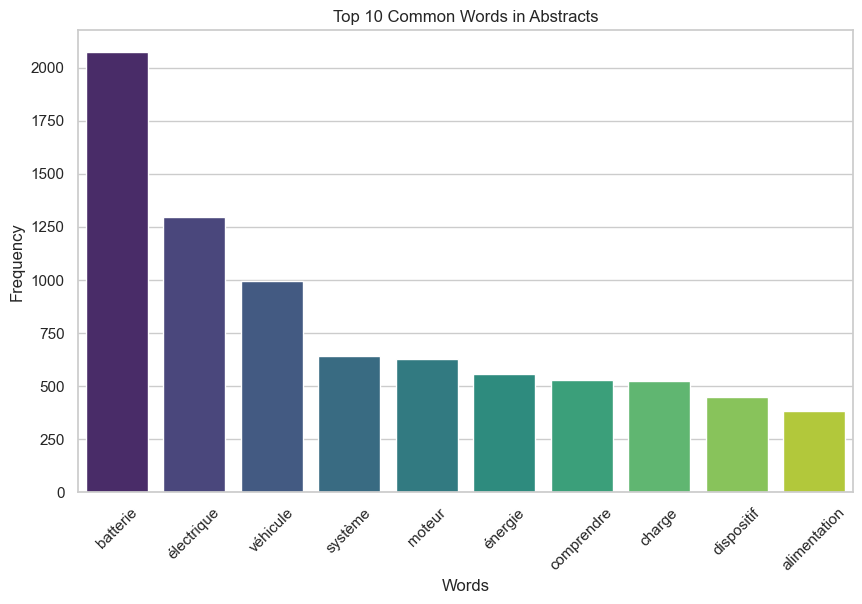

/Users/nouhailanigrou/anaconda3/lib/python3.10/site-packages/seaborn/_oldcore.py:1765: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  order = pd.unique(vector)


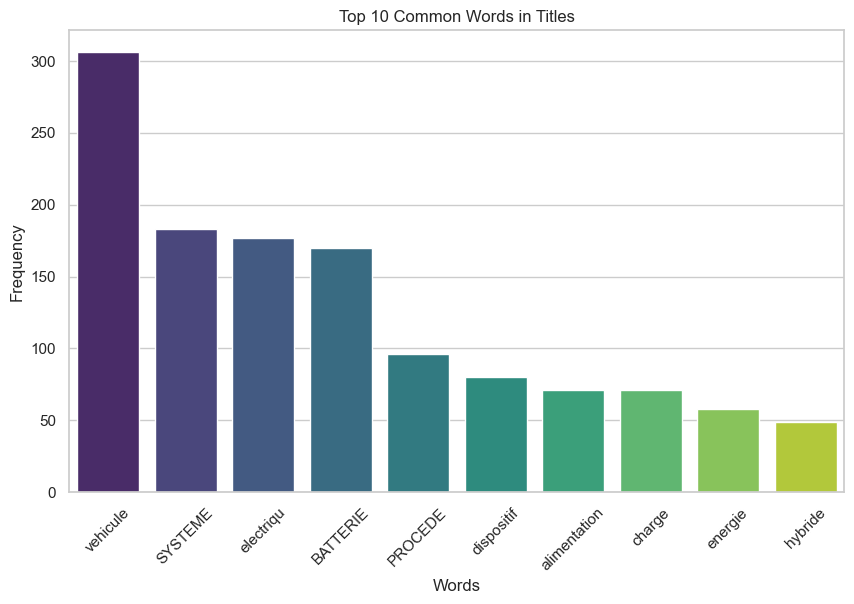

In [125]:
import seaborn as sns
import matplotlib.pyplot as plt
from collections import Counter

# Set seaborn style
sns.set(style="whitegrid")

# Word frequency analysis for text
word_freq_text = Counter()

for text in df['lemmatized_text']:
    words = nltk.word_tokenize(text)
    word_freq_text.update(words)

# Plot word frequency for text
common_words_text = word_freq_text.most_common(10)
words_text, frequencies_text = zip(*common_words_text)

plt.figure(figsize=(10, 6))
sns.barplot(x=list(words_text), y=list(frequencies_text), palette="viridis")
plt.title('Top 10 Common Words in Abstracts')
plt.xlabel('Words')
plt.ylabel('Frequency')
plt.xticks(rotation=45)
plt.show()

# Word frequency analysis for titles
word_freq_title = Counter()

for title in df['lemmatized_title']:
    words = nltk.word_tokenize(title)
    word_freq_title.update(words)

# Plot word frequency for titles
common_words_title = word_freq_title.most_common(10)
words_title, frequencies_title = zip(*common_words_title)

plt.figure(figsize=(10, 6))
sns.barplot(x=list(words_title), y=list(frequencies_title), palette="viridis")
plt.title('Top 10 Common Words in Titles')
plt.xlabel('Words')
plt.ylabel('Frequency')
plt.xticks(rotation=45)
plt.show()


### 03- WordCloud

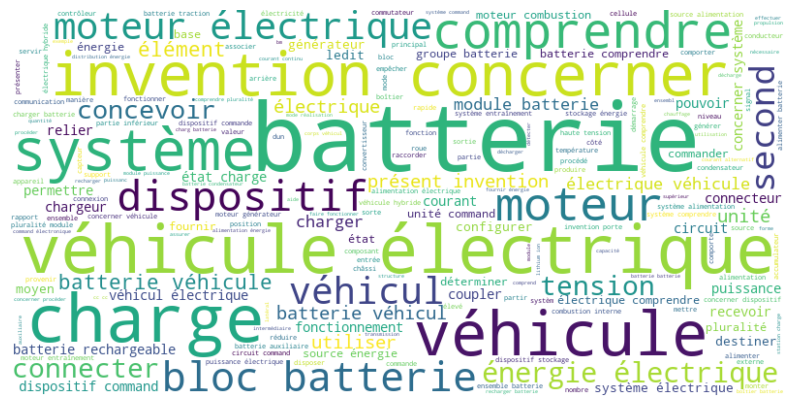

In [126]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Combine all abstracts into a single string
all_abstracts = ' '.join(df['lemmatized_text'])

# Generate word cloud
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(all_abstracts)

# Display the word cloud using matplotlib
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

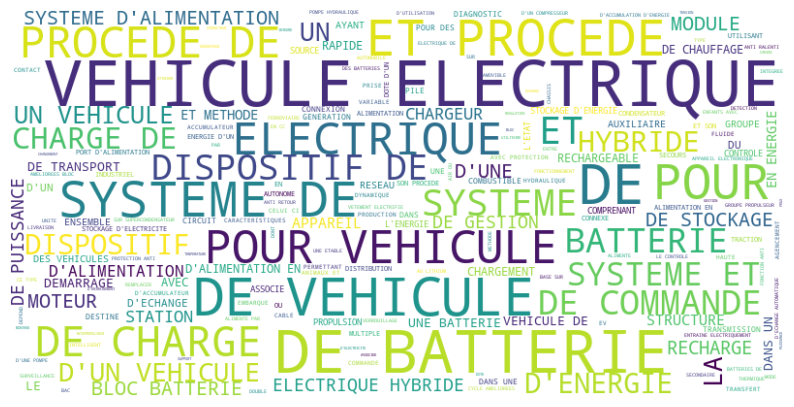

In [127]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Combine all abstracts into a single string
all_abstracts = ' '.join(df['French_Title'])

# Generate word cloud
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(all_abstracts)

# Display the word cloud using matplotlib
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

### 04- Patents Similarity

In [128]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity

french_stop_words = [
    'au', 'aux', 'avec', 'ce', 'ces', 'dans', 'de', 'des', 'du', 'elle', 'en', 'et', 'eux', 'il', 'ils', 
    'je', 'la', 'le', 'les', 'leur', 'lui', 'ma', 'mais', 'me', 'même', 'mes', 'moi', 'mon', 'ne', 'nos', 
    'notre', 'nous', 'on', 'ou', 'par', 'pas', 'pour', 'qu', 'que', 'qui', 'sa', 'se', 'ses', 'son', 'sur', 
    'ta', 'te', 'tes', 'toi', 'ton', 'tu', 'un', 'une', 'vos', 'votre', 'vous', 'l', 'à' 
]

# Create TfidfVectorizer with custom stop words
tfidf_vectorizer = TfidfVectorizer(stop_words=french_stop_words)
tfidf_matrix = tfidf_vectorizer.fit_transform(df['Abstract'])

# Step 2: Compute cosine similarity between all pairs of abstracts
cosine_similarities = cosine_similarity(tfidf_matrix, tfidf_matrix)

# Step 3: Find similar patents for each patent based on cosine similarity
similar_patents = {}
for idx, row in df.iterrows():
    similar_indices = cosine_similarities[idx].argsort()[:-6:-1]  # Exclude self and get top 5 similar patents
    similar_patents[row['French_Title']] = [(df.iloc[i]['French_Title'], cosine_similarities[idx][i]) for i in similar_indices if i != idx]

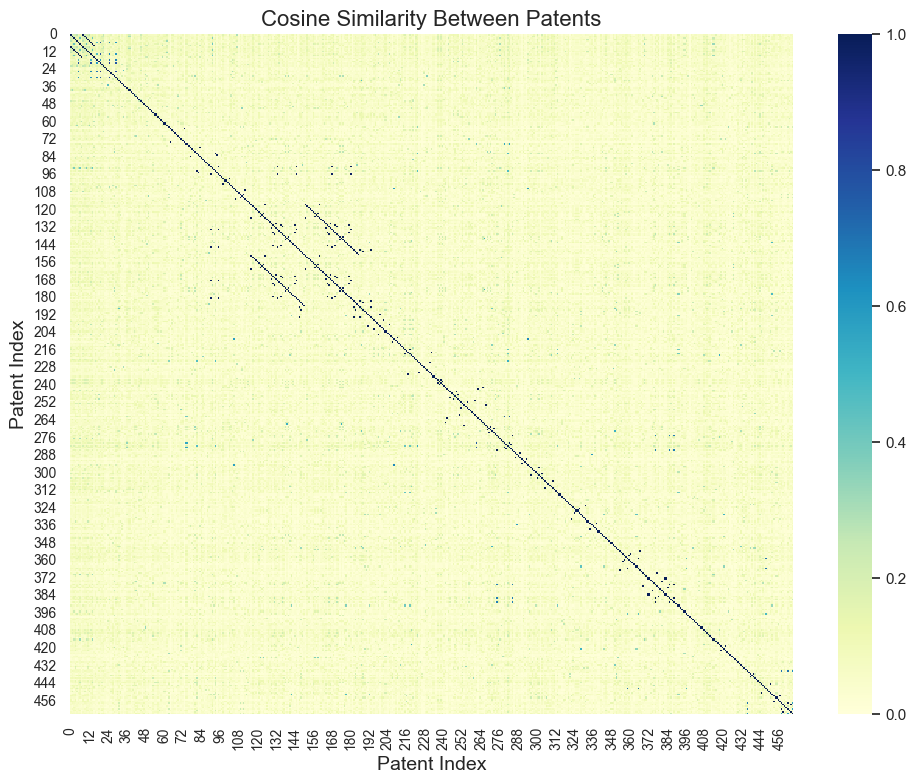

/var/folders/m8/jc8mgx2s41b132cm_njvbmmc0000gn/T/ipykernel_62421/2420161342.py:37: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


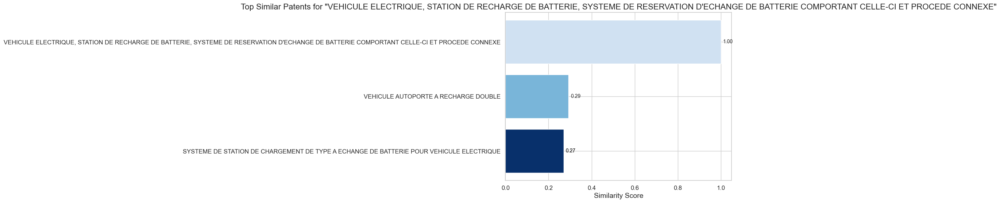

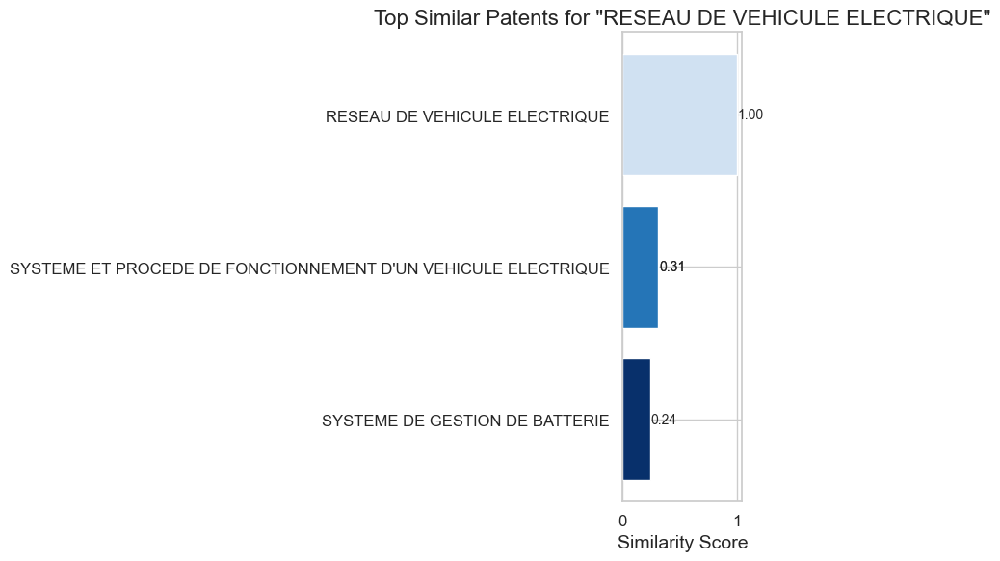

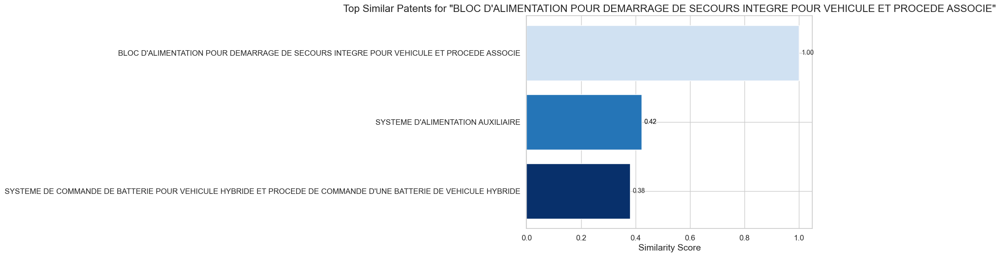

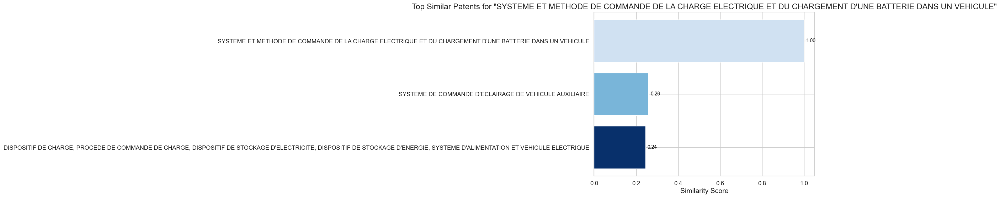

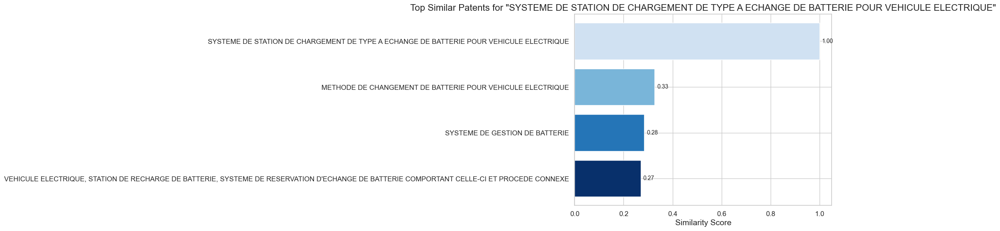

...

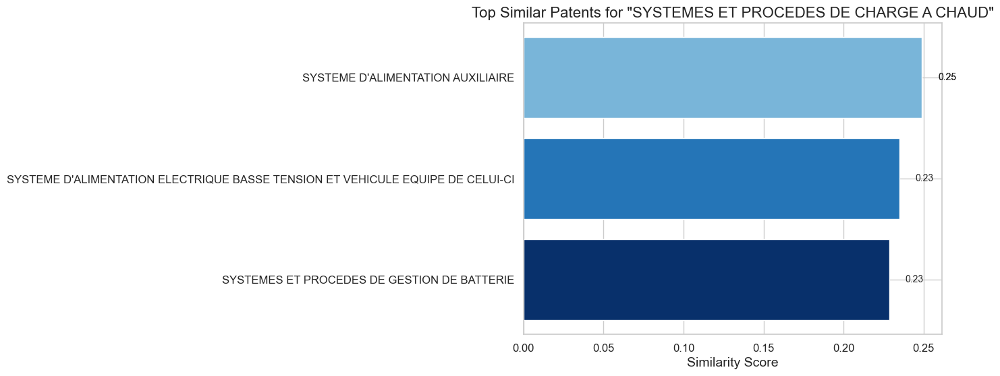

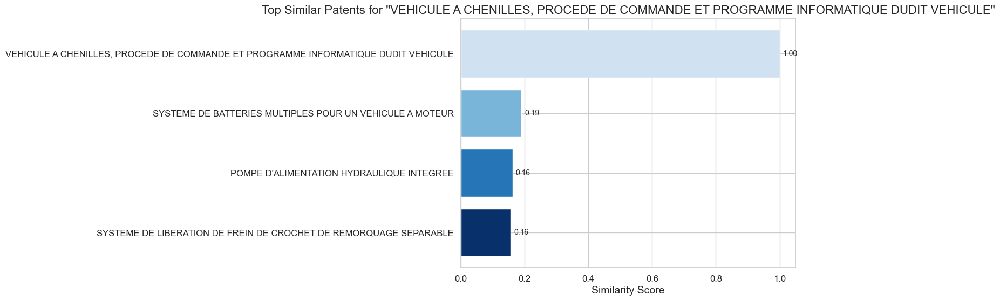

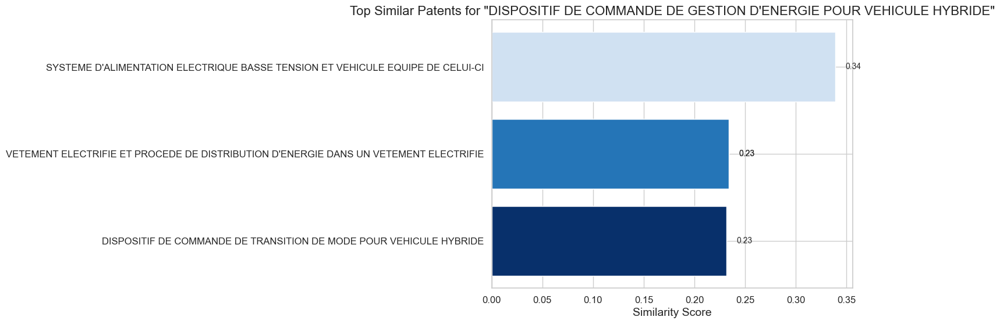

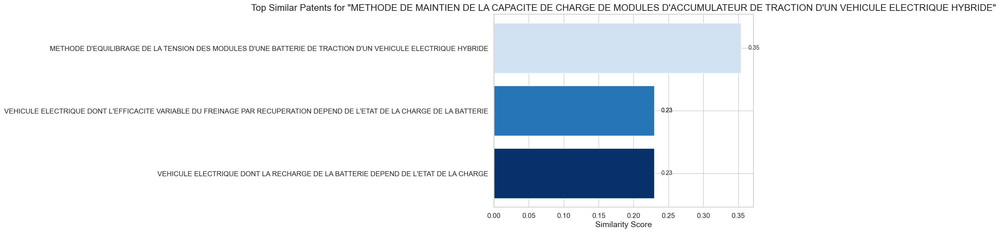

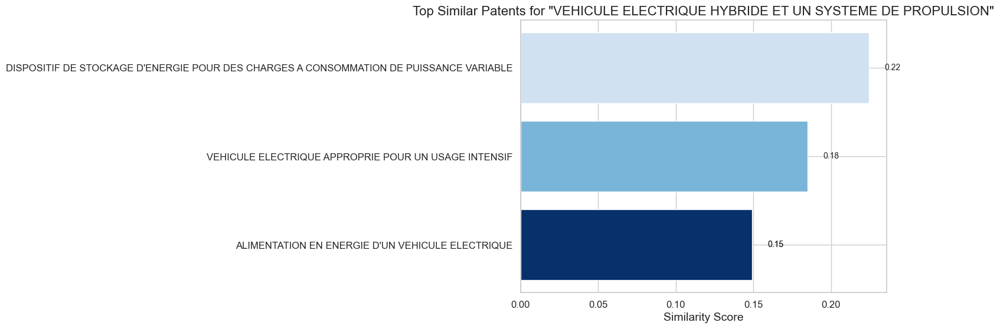

/var/folders/m8/jc8mgx2s41b132cm_njvbmmc0000gn/T/ipykernel_62421/2420161342.py:37: UserWarning: Glyph 131 (\x83) missing from current font.
  plt.tight_layout()
/Users/nouhailanigrou/anaconda3/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 131 (\x83) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


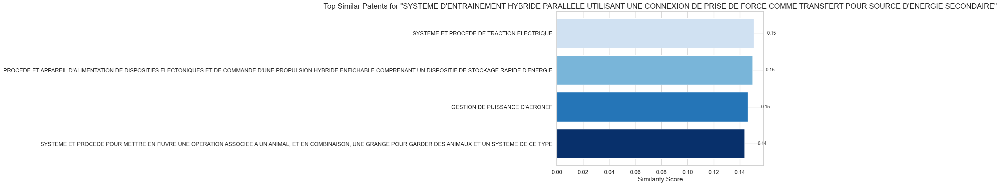

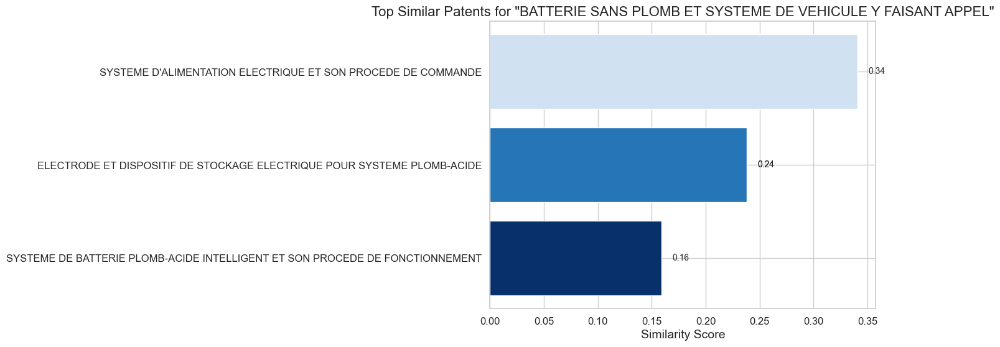

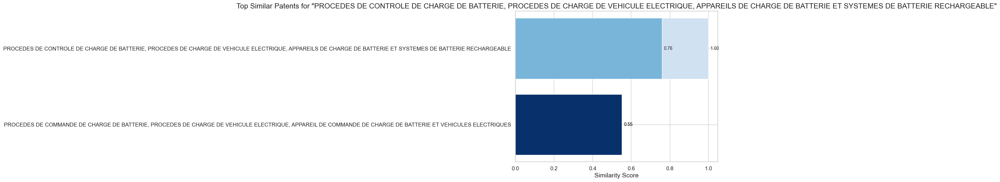

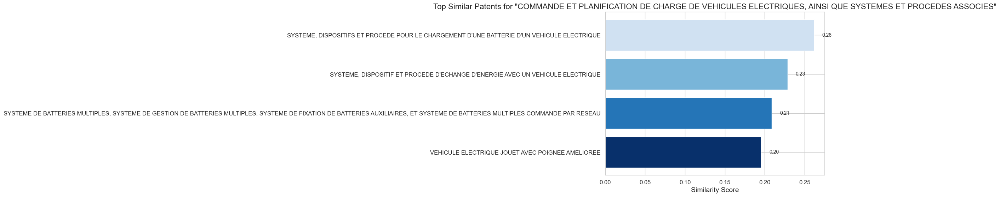

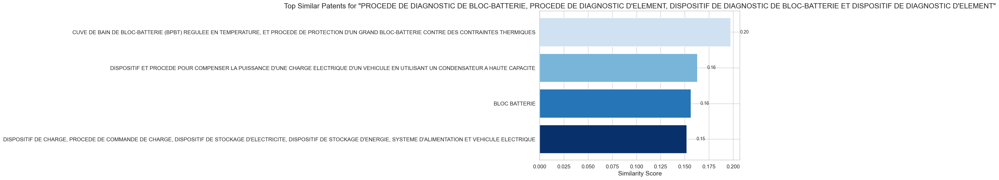

...

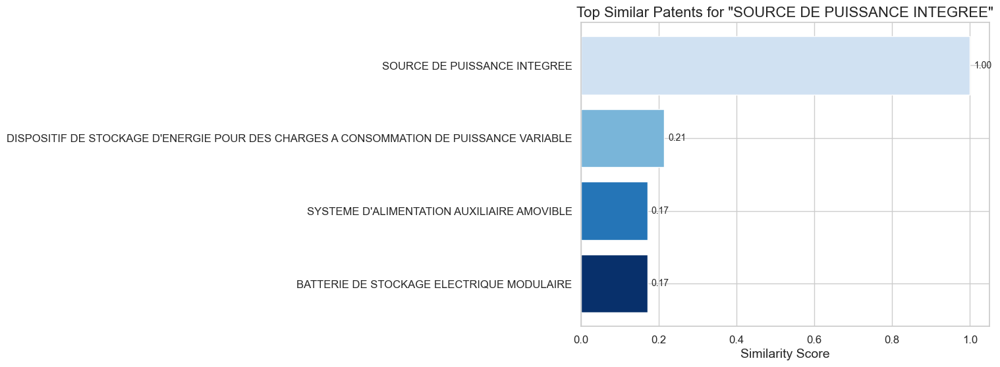

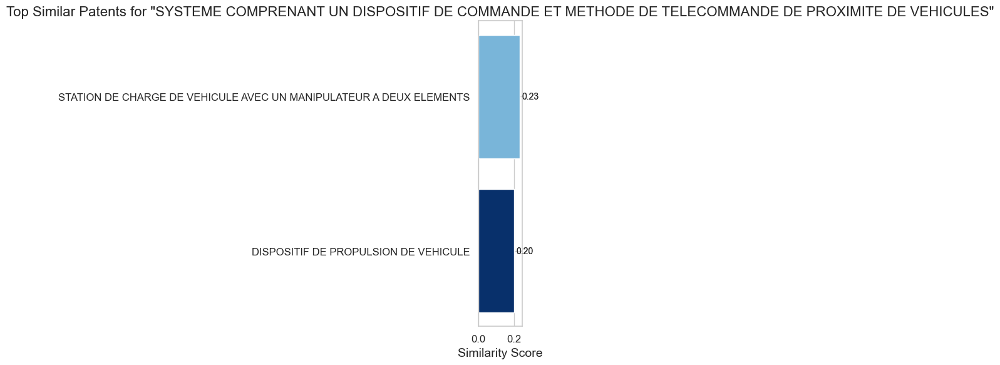

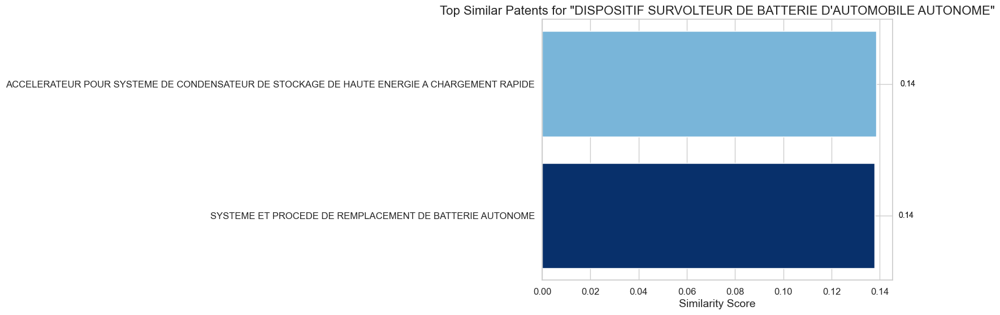

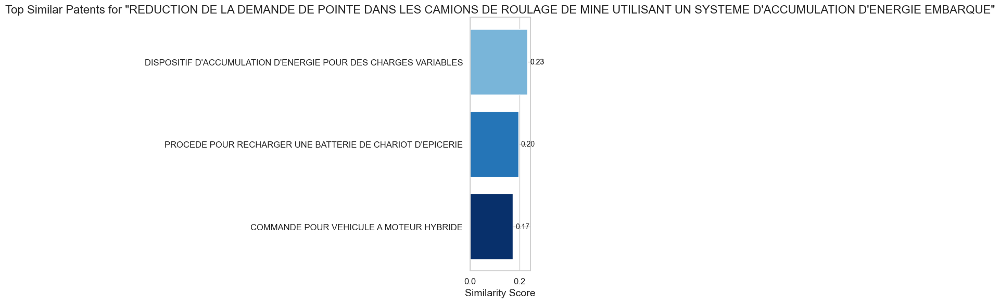

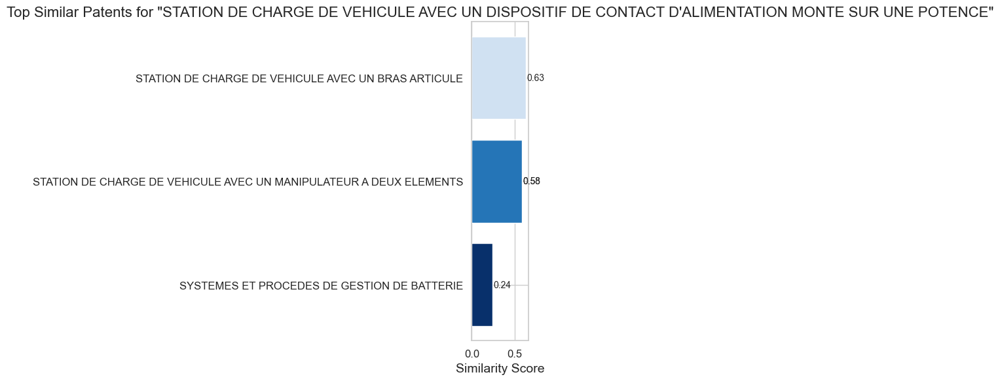

In [129]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Custom color palette for heatmap
colors = sns.color_palette("Blues", as_cmap=True)

# Create a heatmap of cosine similarity matrix
plt.figure(figsize=(10, 8))
sns.heatmap(cosine_similarities, cmap='YlGnBu', annot=False)
plt.title('Cosine Similarity Between Patents', fontsize=16)
plt.xlabel('Patent Index', fontsize=14)
plt.ylabel('Patent Index', fontsize=14)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.tight_layout()
plt.show()

# Visualize top similar patents for each patent in a row
for title, similar_patent_list in similar_patents.items():
    similar_titles, similarity_scores = zip(*similar_patent_list)
    
    # Create a gradient color palette for bars
    gradient_colors = np.linspace(0.2, 1, len(similarity_scores))
    plt.figure(figsize=(8, 6))
    bars = plt.barh(similar_titles, similarity_scores, color=plt.cm.Blues(gradient_colors))
    plt.xlabel('Similarity Score', fontsize=14)
    plt.title(f'Top Similar Patents for "{title}"', fontsize=16)
    plt.gca().invert_yaxis()  # Invert y-axis to display highest similarity at the top
    
    # Add labels to the bars
    for bar, score in zip(bars, similarity_scores):
        plt.text(score + 0.01, bar.get_y() + bar.get_height()/2, f'{score:.2f}', va='center', fontsize=10)
    
    plt.xticks(fontsize=12)
    plt.yticks(fontsize=12)
    plt.tight_layout()
    plt.show()

### 05- Inventor Network

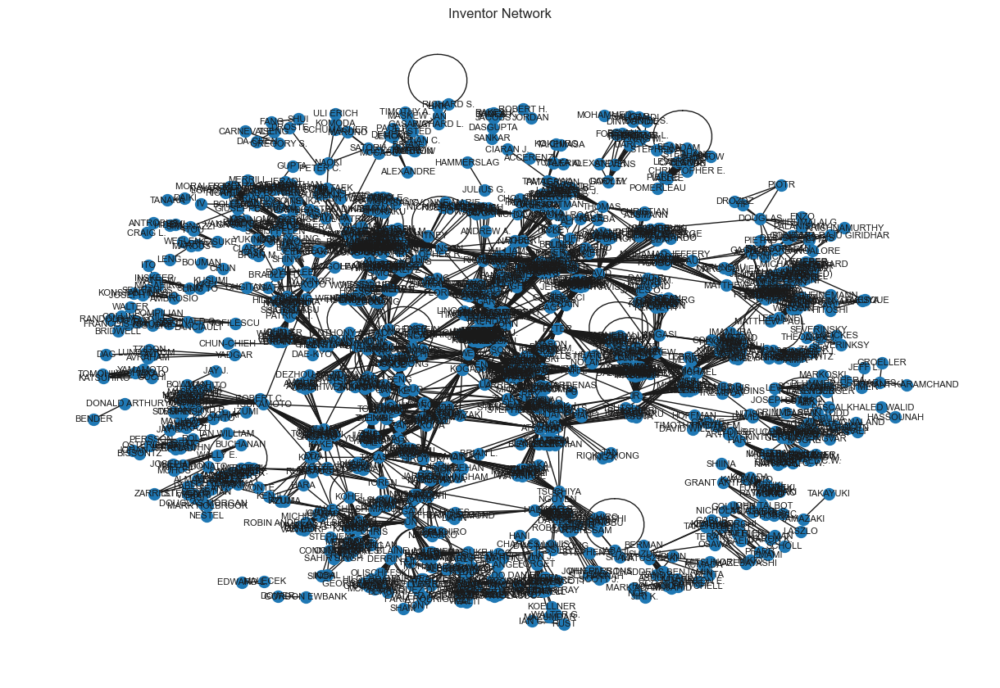

Top 5 Most Central Inventors by Degree Centrality:

WEI: 0.06756756756756757
JASON: 0.054765291607396877
GARY: 0.05120910384068279
KOGA: 0.04836415362731152
SMITH: 0.04836415362731152
****************************************************************************************************

Top 5 Most Central Inventors by Betweenness Centrality:

KOGA: 0.11859133973253941
WEI: 0.11814856735574812
GARY: 0.09011766690498677
TOMOHIRO: 0.06149159509218993
SMITH: 0.05313734083812325
****************************************************************************************************

Top 5 Most Central Inventors by Eigenvector Centrality:

WEI: 0.14129904967080995
JASON: 0.14019540071654935
LOGAN: 0.13735614374279945
GARY: 0.1369197919135587
SMITH: 0.1365287750130078
****************************************************************************************************


In [130]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt

# Construct a co-authorship network of inventors
def build_inventor_network(data):
    G = nx.Graph()
    for _, row in data.iterrows():
        inventors = row['Inventors'].split(', ')  # Split inventors by comma
        # Add edges between inventors who co-authored the same patent
        for i, inventor1 in enumerate(inventors):
            for j, inventor2 in enumerate(inventors):
                if i < j:  # Avoid duplicate edges and self-loops
                    if G.has_edge(inventor1, inventor2):
                        G[inventor1][inventor2]['weight'] += 1  # Increment edge weight
                    else:
                        G.add_edge(inventor1, inventor2, weight=1)  # Add new edge
    return G

# Build the inventor network
inventor_network = build_inventor_network(df)

# Visualize the inventor network
plt.figure(figsize=(12, 8))
pos = nx.spring_layout(inventor_network, k=0.1)  # Position nodes using force-directed layout
nx.draw(inventor_network, pos, with_labels=True, node_size=100, font_size=8)
plt.title('Inventor Network')
plt.show()

# Calculate centrality measures
degree_centrality = nx.degree_centrality(inventor_network)
betweenness_centrality = nx.betweenness_centrality(inventor_network)
eigenvector_centrality = nx.eigenvector_centrality(inventor_network)

# Print the top 5 most central inventors for each centrality measure
print("Top 5 Most Central Inventors by Degree Centrality:")
print()
for inventor, centrality in sorted(degree_centrality.items(), key=lambda x: x[1], reverse=True)[:5]:
    print(f"{inventor}: {centrality}")
print('*'*100)

print("\nTop 5 Most Central Inventors by Betweenness Centrality:")
print()
for inventor, centrality in sorted(betweenness_centrality.items(), key=lambda x: x[1], reverse=True)[:5]:
    print(f"{inventor}: {centrality}")
print('*'*100)

print("\nTop 5 Most Central Inventors by Eigenvector Centrality:")
print()
for inventor, centrality in sorted(eigenvector_centrality.items(), key=lambda x: x[1], reverse=True)[:5]:
    print(f"{inventor}: {centrality}")
print('*'*100)

### Degree Centrality:
- Degree centrality measures the number of connections (edges) that an inventor has in the network.
- For example, "WEI" has a degree centrality of approximately 0.0676, indicating that they are directly connected to about 6.76% of all other inventors in the network.

### Betweenness Centrality:
- Betweenness centrality quantifies the extent to which an inventor lies on the shortest paths between other pairs of inventors in the network.
- "KOGA" has the highest betweenness centrality with approximately 0.1186, suggesting that they act as a bridge or connector between different groups of inventors in the collaboration network.

### Eigenvector Centrality:
- Eigenvector centrality measures the influence of an inventor in the network based on the influence of their neighbors.
- "WEI" has the highest eigenvector centrality with approximately 0.1413, indicating that they are connected to other influential inventors in the network.

### Leveraging Centrality Measures in Inventor Networks

Centrality measures in inventor networks offer valuable insights that can be leveraged in various ways:

1. **Identifying Key Collaborators**: Pinpoint inventors with high centrality scores to identify valuable partners for collaborative research and innovation initiatives.

2. **Promoting Collaboration**: Facilitate interdisciplinary collaborations and knowledge exchange by connecting inventors with high centrality to others in the network.

3. **Strategic Decision-Making**: Use centrality information to inform resource allocation, investment decisions, and partnership strategies to maximize the impact of research efforts.

4. **Network Optimization**: Optimize inventor networks by strategically connecting inventors with complementary expertise and facilitating knowledge transfer to enhance collaboration effectiveness.

### 06- Geospatial Analysis

In [131]:
import geopandas as gpd
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable

# Read the world map dataset
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

# Merge the world map dataset with the patent counts by country
world = world.merge(country_counts, how='left', left_on='name', right_on='Country')

# Plot the choropleth map
fig, ax = plt.subplots(1, 1, figsize=(15, 10))
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)

world.plot(column='Patent_Count', ax=ax, legend=True, cmap='Blues', cax=cax, legend_kwds={'label': "Number of Patents Filed"})
for idx, row in world.iterrows():
    ax.text(row.geometry.centroid.x, row.geometry.centroid.y, row['name'], fontsize=8, ha='center')
plt.title('Geographical Distribution of Patent Filings by Country')
plt.show()

/var/folders/m8/jc8mgx2s41b132cm_njvbmmc0000gn/T/ipykernel_62421/3141914684.py:6: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


NameError: name 'country_counts' is not defined

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Convert 'Filled_Date' column to datetime format
df['Filled_Date'] = pd.to_datetime(df['Filled_Date'], errors='coerce')
df['Issued'] = pd.to_datetime(df['Issued'], errors='coerce')

# Remove rows with NaT (invalid dates)
df.dropna(subset=['Filled_Date', 'Issued'], inplace=True)

# Time Series Analysis: Calculate number of patents filed and issued for each year
patents_filed_by_year = df['Filled_Date'].dt.year.value_counts().sort_index()
patents_issued_by_year = df['Issued'].dt.year.value_counts().sort_index()

# Visualization: Plot the number of patents filed over time (Time Series Plot)
plt.figure(figsize=(10, 6))
patents_filed_by_year.plot(kind='line', marker='o', color='skyblue', label='Patents Filed')
plt.title('Number of Patents Filed Over Time')
plt.xlabel('Year')
plt.ylabel('Number of Patents Filed')
plt.grid(True)
plt.legend()
plt.show()

# Visualization: Visualize the distribution of patents issued over different years (Histogram)
plt.figure(figsize=(10, 6))
patents_issued_by_year.plot(kind='bar', color='blue', alpha=0.7)
plt.title('Distribution of Patents Issued Over Different Years')
plt.xlabel('Year')
plt.ylabel('Number of Patents Issued')
plt.grid(axis='y')
plt.xticks(rotation=45)
plt.show()